In [206]:
%load_ext autoreload
%cd /home/zano/Documents/TESI/FOLDER_CINECA/
%autoreload 2
import platform
import os

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
/home/zano/Documents/TESI/FOLDER_CINECA


This is now an optional IPython functionality, setting dhist requires you to install the `pickleshare` library.


# UNIFIED DATA SELECTION

In [207]:
# Set the DATA_ROOT environment variable before calling get_data_directory
os.environ["DATA_ROOT"] = "/home/zano/Documents/TESI/FOLDER_CINECA/data"
os.environ["PROJ_ROOT"] = "/home/zano/Documents/TESI/FOLDER_CINECA"
os.environ["MLFLOW_TRACKING_URI"] = "file:/home/zano/Documents/TESI/FOLDER_CINECA/mlruns"

In [208]:
# Now you can proceed with your existing code
from utils.directory_functions import get_data_directory, get_base_directory
num_input_channels = 4 #int(input("Enter the number of input channels (3 or 4): "))

data_dir = get_data_directory(num_input_channels=num_input_channels)
print("data dir:", data_dir)
base_dir = get_base_directory()
print("base_dir:", base_dir)

# start mlflow ui
from utils.mlflow_functions import *
from utils.directory_functions import *

tracking_uri = get_tracking_uri()
mlflow.set_tracking_uri(tracking_uri)
start_mlflow_ui(tracking_uri) # start mlflow ui

data dir: /home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP
base_dir: /home/zano/Documents/TESI/FOLDER_CINECA
Starting MLflow UI on port file:/home/zano/Documents/TESI/FOLDER_CINECA/mlruns …  logs → mlflow_ui.log


In [209]:
# import ipywidgets as widgets
# from IPython.display import display

# CLASS_NAME_SETS = {
#     "MSA vs Control": ["MSA", "control"],
#     "MSA vs PD": ["MSA", "PD"],
#     "MSA-P vs MSA-C": ["MSA-P", "MSA-C"],
#     "MSA-P vs PD": ["MSA-P", "PD"],
#     "PD vs MSA-P vs MSA-C": ["PD", "MSA-P", "MSA-C"]
# }

# dropdown = widgets.Dropdown(
#     options=list(CLASS_NAME_SETS.keys()),
#     value="MSA vs PD",
#     description='Class Set:',
#     style={'description_width': 'initial'}
# )

# def on_dropdown_change(change):
#     """
#     Update the class_names variable when the dropdown selection changes.
#     """
#     global class_names
#     if change['type'] == 'change' and change['name'] == 'value':
#         class_names = CLASS_NAME_SETS[change['new']]
#         print(f"class_names set to: {class_names}")


# class_names = CLASS_NAME_SETS[dropdown.value]

# dropdown.observe(on_dropdown_change)

# display(dropdown)

In [210]:
class_names = ["MSA", "PD"] #
    #or  "MSA vs PD": ["MSA", "PD"],
    # "MSA-P vs MSA-C": ["MSA-P", "MSA-C"],
    # "MSA-P vs PD": ["MSA-P", "PD"],
    # "PD vs MSA-P vs MSA-C": ["PD", "MSA-P", "MSA-C"]

# DATA EXTRACTION

{'MSA': '/home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/MSA', 'PD': '/home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/PD'}
Class directories:
{'MSA': '/home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/MSA', 'PD': '/home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/PD'}
MSA images (before filtering): 'gh' count: 104, 'vaso' count: 0
After removing 'vaso', MSA images: 'gh' count: 104, 'vaso' count: 0
PD images (before filtering): 'gh' count: 60, 'vaso' count: 0
After removing 'vaso', PD images: 'gh' count: 60, 'vaso' count: 0


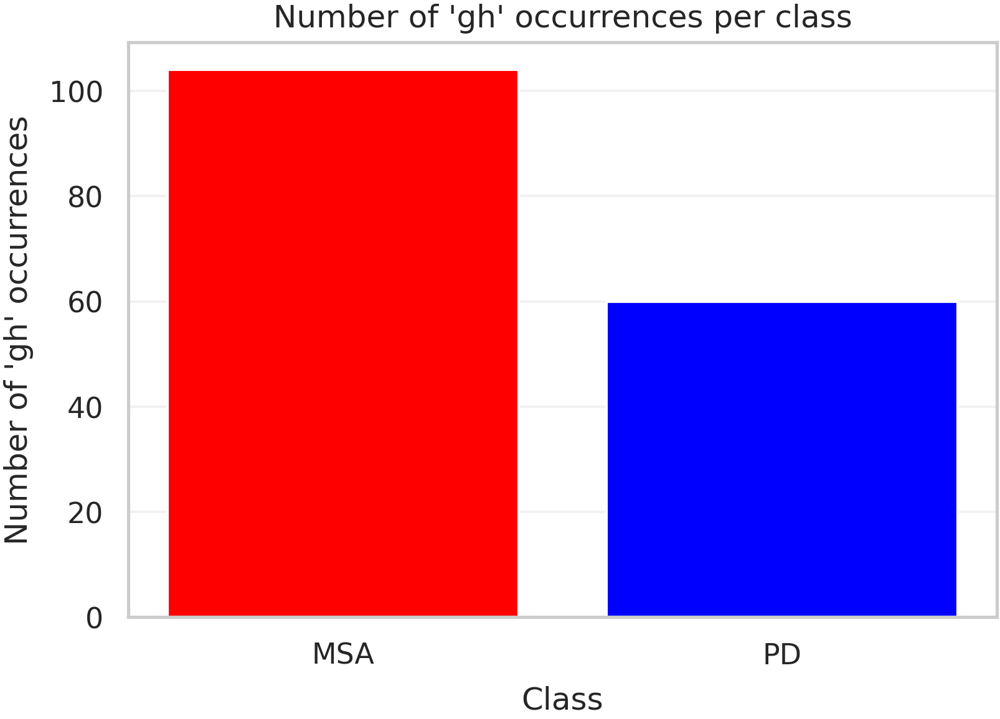


Checking image shapes:
MSA image: MAX_4092.lif - 4092 DL VIP red Sinapto gr TH b D grey 63x z 2 pinhole 1 z 05 gh 2.tif  dtype: uint8, shape: (4, 1024, 1024)
MSA image: MAX_4092.lif - 4092 DL VIP red Sinapto gr TH b D grey 63x z 2 pinhole 1 z 05 gh.tif  dtype: uint8, shape: (4, 1024, 1024)
MSA image: MAX_4121.lif - 4121 DL VIP red Sinapto gr TH b D grey 63x z 2 pinhole 1 z 05 gh 2.tif  dtype: uint8, shape: (4, 1024, 1024)
MSA image: MAX_4121.lif - 4121 DL VIP red Sinapto gr TH b D grey 63x z 2 pinhole 1 z 05 gh.tif  dtype: uint8, shape: (4, 1024, 1024)
MSA image: MAX_5358.lif - 5358 DL VIP red Sinapto gr TH b D grey 63x z 2 pinhole 1 z 05 gh.tif  dtype: uint8, shape: (4, 1024, 1024)
MSA image: MAX_5358.lif - 5358 DL VIP red Sinapto gr TH b D grey 63x z 2 pinhole 1 z 05 gh2.tif  dtype: uint8, shape: (4, 1024, 1024)
MSA image: MAX_5435 gh.tif  dtype: uint8, shape: (4, 1024, 1024)
MSA image: MAX_5435 gh2.tif  dtype: uint8, shape: (4, 1024, 1024)
MSA image: MAX_5463 gh.tif  dtype: uint8, 

In [211]:
# Create a dictionary mapping each class to its directory
class_dirs = {}
three_classes = (len(class_names) == 3)

for class_name in class_names:
    class_dirs[class_name] = os.path.join(data_dir, class_name)
    
print(class_dirs)
if three_classes:
    class2_name, class1_name, class0_name = class_names
    class2_dir, class1_dir, class0_dir = class_dirs.values()
else:
    class1_name, class0_name = class_names
    class1_dir, class0_dir = class_dirs.values()

print("Class directories:")
print(class_dirs)

# Dictionaries to store image paths and counts for each class
images_paths_dict = {}
counts_dict = {}

# Loop over classes to process each folder
for class_name in class_names:
    class_dir = class_dirs[class_name]
    image_paths = sorted(glob.glob(os.path.join(class_dir, "*.tif")))
    
    # Check if images were found; otherwise raise an error
    if not image_paths:
        raise FileNotFoundError(f"No TIFF image file found in {class_dir}")
    
    # Count occurrences of 'gh' and 'vaso' in the filenames (using .lower() for case insensitivity)
    gh_count = sum('gh' in os.path.basename(path).lower() for path in image_paths)
    vaso_count = sum('vaso' in os.path.basename(path).lower() for path in image_paths)
    print(f"{class_name} images (before filtering): 'gh' count: {gh_count}, 'vaso' count: {vaso_count}")
    
    # Filter out images that contain 'vaso' (if needed)
    image_paths = [path for path in image_paths if 'vaso' not in os.path.basename(path).lower()]
    gh_count_after = sum('gh' in os.path.basename(path).lower() for path in image_paths)
    vaso_count_after = sum('vaso' in os.path.basename(path).lower() for path in image_paths)
    print(f"After removing 'vaso', {class_name} images: 'gh' count: {gh_count_after}, 'vaso' count: {vaso_count_after}")
    
    # Store the filtered image paths and counts for later use
    images_paths_dict[class_name] = image_paths
    counts_dict[class_name] = {"gh_count": gh_count_after, "vaso_count": vaso_count_after}

# Visualize the number of 'gh' counts per class in a bar chart
plt.figure()
plt.xlabel("Class")
plt.ylabel("Number of 'gh' occurrences")
plt.title("Number of 'gh' occurrences per class")
bar_heights = [counts_dict[cn]["gh_count"] for cn in class_names]
bar_colors = ['red', 'blue', 'lightblue']
plt.bar(class_names, bar_heights, color=bar_colors)
plt.show()

# --- Debug: Check image shapes after initial loading ---
print("\nChecking image shapes:")
for class_name, image_paths in images_paths_dict.items():
    for path in image_paths:
        img = tifffile.imread(path)  # Read image as a numpy array
        print(f"{class_name} image: {os.path.basename(path)}  dtype: {img.dtype}, shape: {img.shape}")

# Combine image paths and labels for the three classes; 
# the label here is simply the index of the class in class_names (0, 1, 2)
combined = [] # List to store tuples of (image_path, label)
for label, class_name in enumerate(class_names):
    for path in images_paths_dict[class_name]:
        combined.append((path, label))
# print("\nSample of combined image paths and labels:", combined[:5])
random.shuffle(combined)  # Shuffle the combined list to mix classes

# Optionally, determine the minority label for resampling purposes
counts = {label: len(images_paths_dict[class_name]) for label, class_name in enumerate(class_names)}
minority_label = min(counts, key=counts.get)
print(f"\nMinority label for resampling purposes: {minority_label}")

# Unzip the combined list back into separate tuples (if needed)
images_paths, labels = zip(*combined)
print("\nSample of image paths:", images_paths[:5])
print("Total images found:", len(combined))

# Optionally, convert to NumPy arrays (helpful for further processing or k-fold splitting)
images_paths_np = np.array(images_paths)
labels_np = np.array(labels)
print("\nSample of image paths (NumPy):", images_paths_np[:5])
print((labels_np))
#print(X)

## TEST SET SPLIT

In [212]:
# NB the test set must be splitted BEFORE oversampling to avoid data leakage!
# -------------------------------------------------------------------------
#from sklearn.model_selection import train_test_split
#returns numpy arrays containing the paths to images and the labels
# print(cfg.data_splitting["random_seed"])
train_images_paths, test_images_paths, train_true_labels, test_true_labels = train_test_split(
    images_paths_np,
    labels_np,
    test_size = 0.1,
    stratify=labels,
    random_state=42
)


test_images_paths_np = np.array(test_images_paths)
test_true_labels_np = np.array(test_true_labels)

print("train images paths:", train_images_paths)
print("true test labels:", test_true_labels)
# # For the cross-validation, we'll use train_images_paths and labels_temp
train_images_paths_np = np.array(train_images_paths) #contains the images paths
train_labels_np = np.array(train_true_labels) #contains the labels

all_images_paths = np.concatenate((train_images_paths_np, test_images_paths_np))
all_labels = np.concatenate((train_labels_np, test_true_labels_np))

print(f"{train_images_paths_np.shape[0]} training images")
print(f"{len(test_images_paths)} test images")
#test_images_paths = [os.path.basename(path) for path in test_images_paths]
print(test_images_paths)
print(type(train_images_paths))


train images paths: ['/home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/MSA/MAX_6308.lif - 6308 DL VIP red Sinapto gr TH b D grey 63x z 2 pinhole 1 z 05 gh.tif'
 '/home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/MSA/MAX_6311.lif - 6311 DL VIP red Sinapto gr TH b D grey 63x z 2 pinhole 1 z 05 gh 2.tif'
 '/home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/MSA/MAX_7037.lif - 7037 DL VIP red Sinapto gr TH b D grey 63x z 2 pinhole 1 z 05 gh2.tif'
 '/home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/MSA/MAX_7857.lif - 7857 DL VIP red Sinapto gr TH b D grey 63x z 2 pinhole 1 z 05 gh2.tif'
 '/home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/MSA/MAX_5954 gh2.tif.tif'
 '/home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/MSA/MAX_7185.lif - 7185 DL VIP red Sinapto gr TH b D grey 63x z 2 pinhole 1 z 05 gh  n2.tif'
 '/home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/MSA/MAX_6237.lif - 6237 DL VIP red Sinapto gr TH b D grey 63x z 2 pinhole 1 z 05 gh2.tif'
 '/home/zano/Documents/TESI/FOLDE

# TEST SPLIT AND DATA VISUALIZATION

In [213]:
%matplotlib inline

Figure saved to images/channels_intensity_ecdf.png


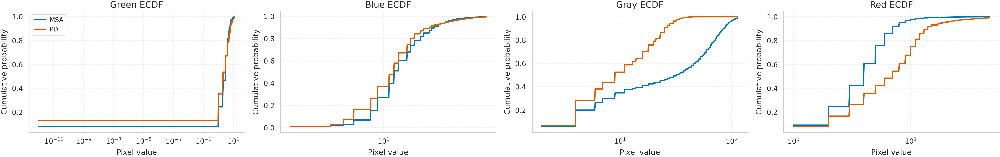

In [214]:
from utils.data_visualization_functions import visualize_and_compare_pixel_intensity_histograms, plot_intensity_ecdf

# Example Usage (assuming you have images_balanced_paths and labels_balanced defined):
# visualize_and_compare_pixel_intensity_histograms(images_paths_np, labels_np, class1_name, class0_name)
# plt.show()

plot_intensity_ecdf(
    img_paths=images_paths_np,
    labels=labels_np,
    class1_name="PD",
    class0_name="MSA",
    output_path="images/channels_intensity_ecdf.png",
    robust_zoom=True,       # zoom to robust per-channel limits
    lower_percentile=0.5,
    upper_percentile=99.5,
    log_x=True              # set True if intensities > 0
)
# print("test images intenisty distribution")
# visualize_and_compare_pixel_intensity_histograms(test_images_paths_np, test_true_labels_np, class1_name, class0_name)

## TEST SET VISUALIZATIONS

 Image0 : /home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/MSA/MAX_6663.lif - 6663 DL VIP red Sinapto gr TH b D grey 63x z 2 pinhole 1 z 05 gh 2.tif


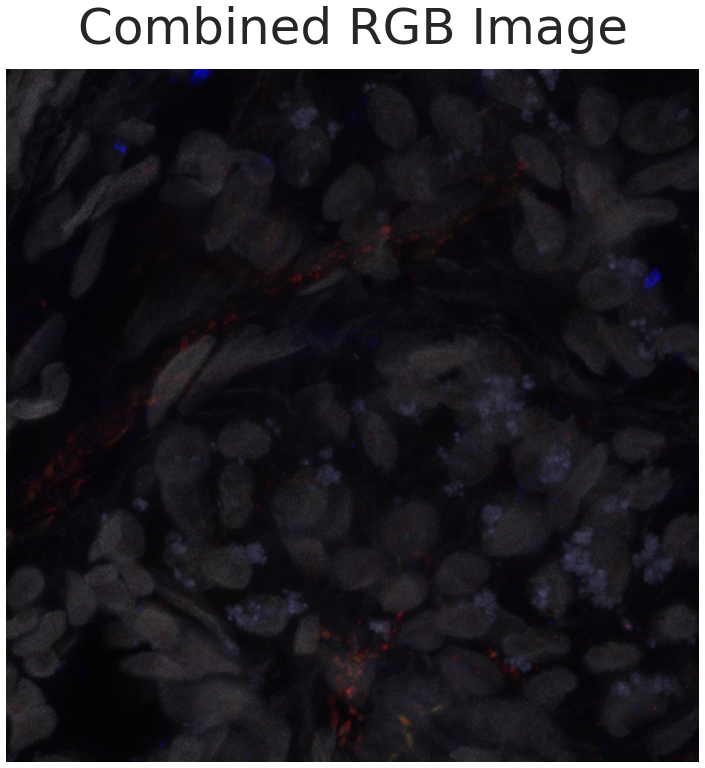

 Image1 : /home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/MSA/MAX_7239.lif - 7239 DL VIP red Sinapto gr TH b D grey 63x z 2 pinhole 1 z 05 gh 2.tif


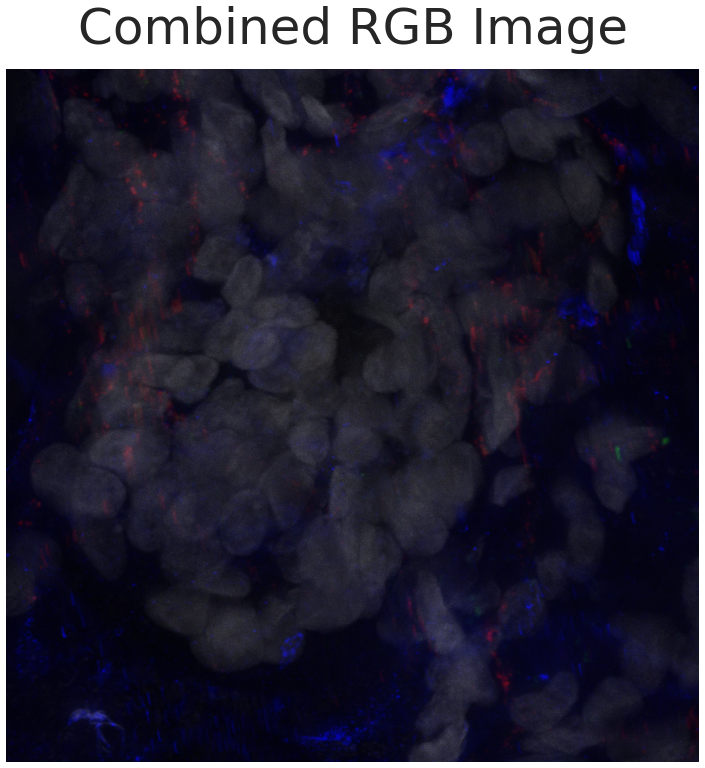

 Image2 : /home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/MSA/MAX_6663.lif - 6663 DL VIP red Sinapto gr TH b D grey 63x z 2 pinhole 1 z 05 gh.tif


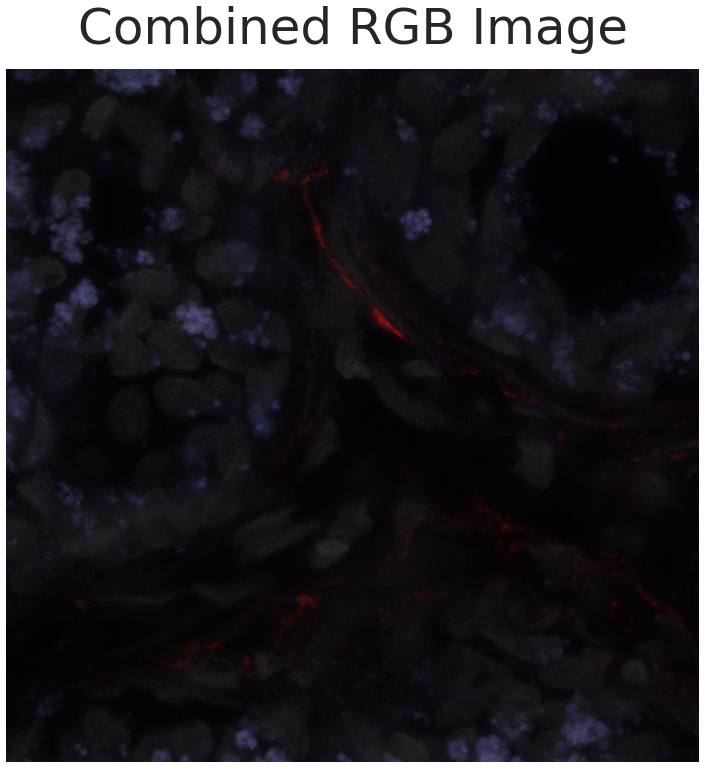

 Image3 : /home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/MSA/MAX_6657.lif - 6657 DL VIP red Sinapto gr TH b D grey 63x z 2 pinhole 1 z 05 gh.tif


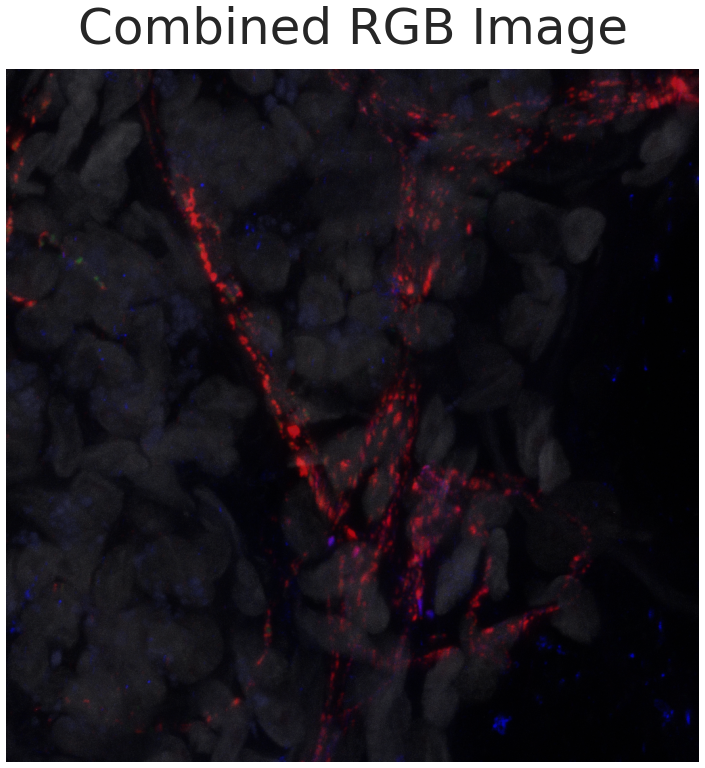

 Image4 : /home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/MSA/MAX_7114.lif - 7144 DL VIP red Sinapto gr TH b D grey 63x z 2 pinhole 1 z 05 gh.tif


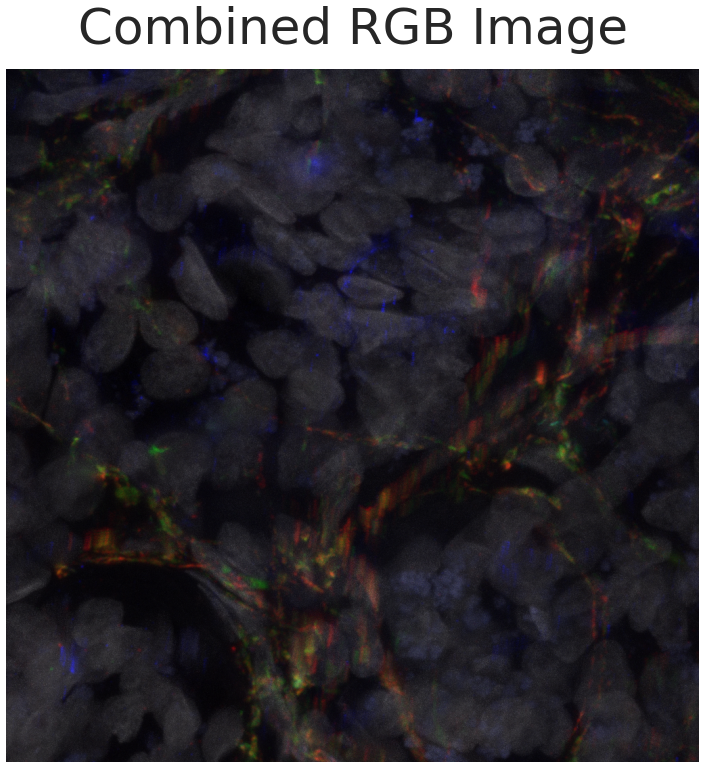

 Image5 : /home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/PD/MAX_6749.lif - 6749 DL VIP red Sinapto gr TH b D grey 63x z 2 pinhole 1 z 05 gh 2.tif


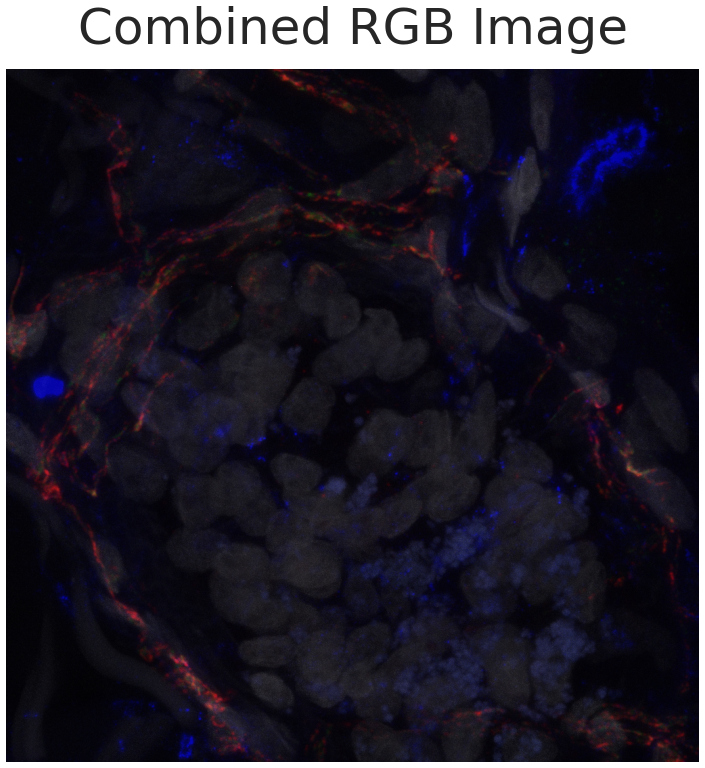

 Image6 : /home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/MSA/MAX_5767.lif - 5767 DL VIP r TH b Sinapto gr DAPI grey 63x z2 gh pinhole 1 z 05.tif


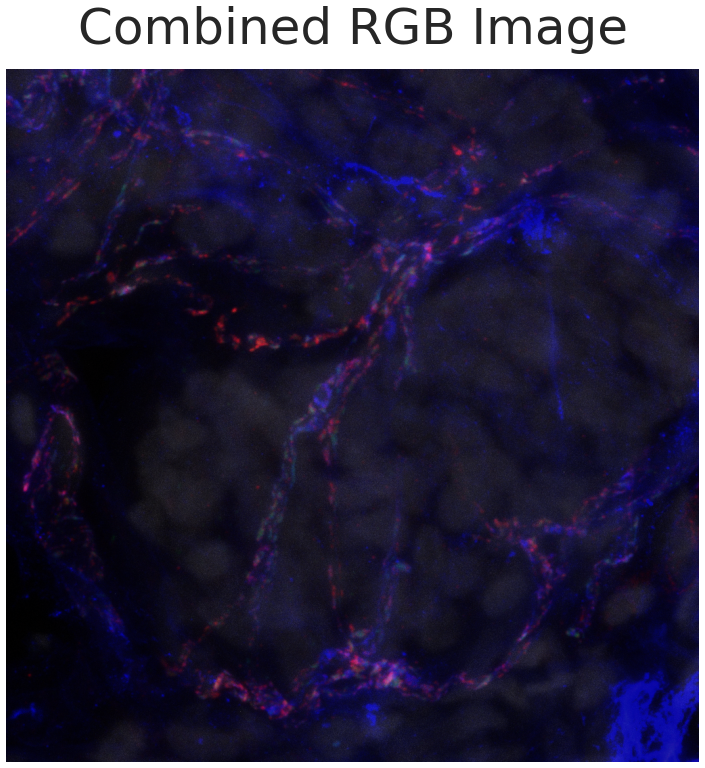

 Image7 : /home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/MSA/MAX_5717.lif - 5717 DL VIP r TH b Sinapto gr DAPI grey 63x z2 gh 2 pinhole 1 z 05.tif


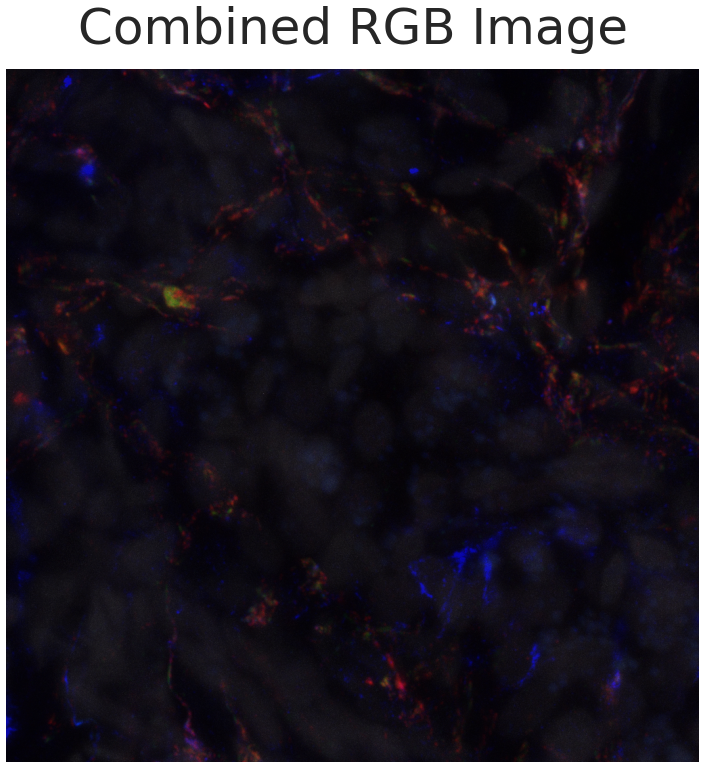

 Image8 : /home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/PD/MAX_6773.lif - 6773 DL VIP red Sinapto gr TH b D grey 63x z 2 pinhole 1 z 05 gh.tif


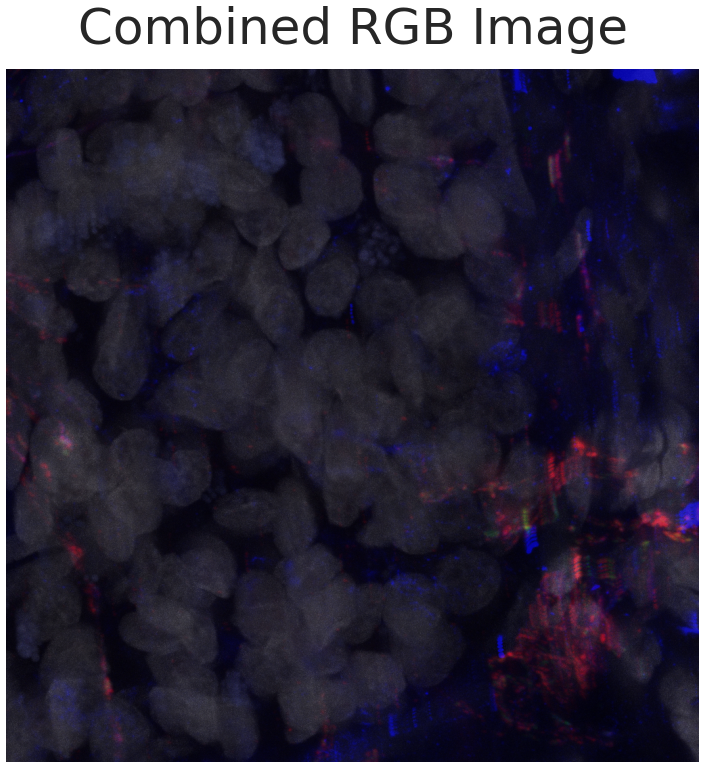

 Image9 : /home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/PD/MAX_6571.lif - 6571 DL VIP red Sinapto gr TH b D grey 63x z 2 pinhole 1 z 05 gh.tif


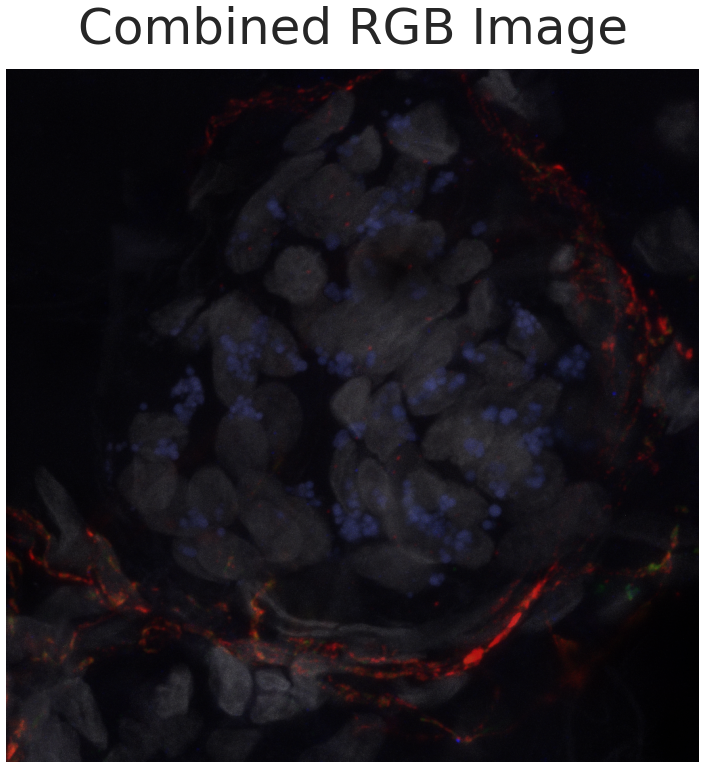

 Image10 : /home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/PD/MAX_6616.lif - 6616 DL VIP red Sinapto gr TH b D grey 63x z 2 pinhole 1 z 05 gh  n2.tif


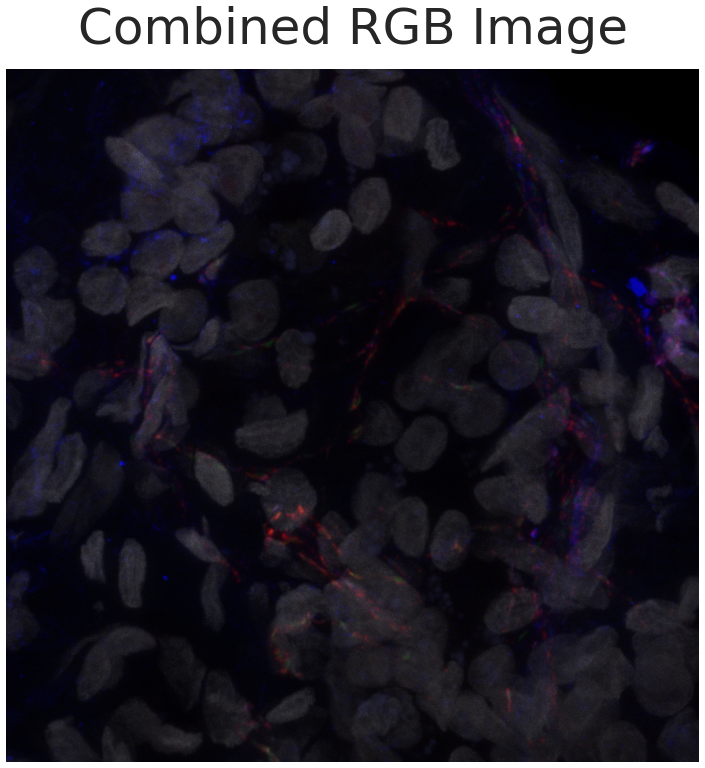

 Image11 : /home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/PD/MAX_7229.lif - 7229 DL VIP red Sinapto gr TH b D grey 63x z 2 pinhole 1 z 05 gh.tif


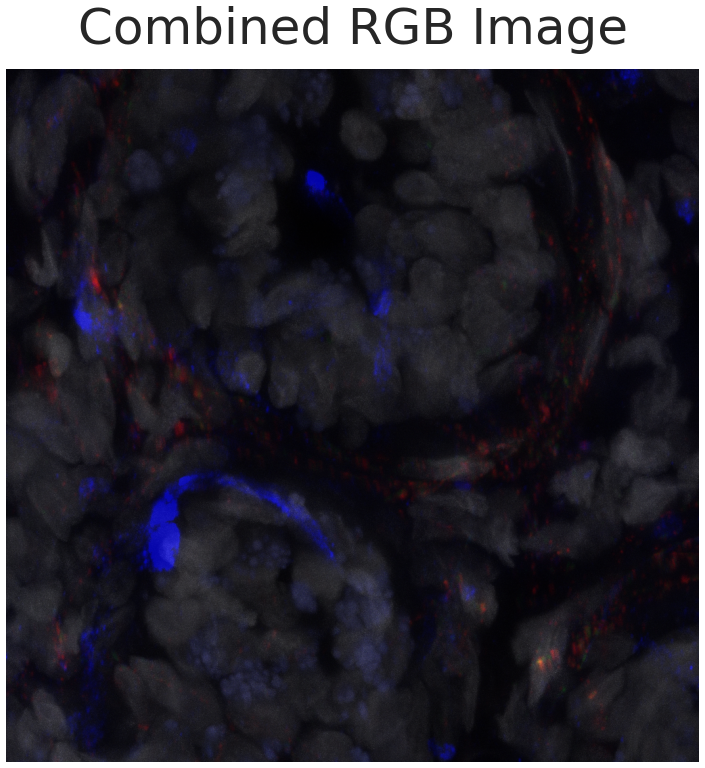

 Image12 : /home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/MSA/MAX_7893.lif - 7893 DL VIP red Sinapto gr TH b D grey 63x z 2 pinhole 1 z 05 gh2.tif


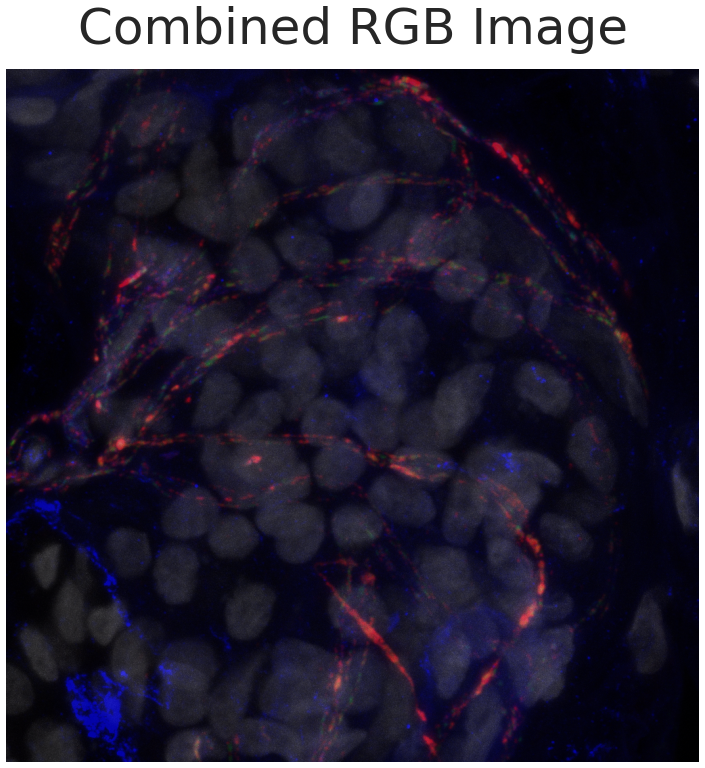

 Image13 : /home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/MSA/MAX_5435 gh2.tif


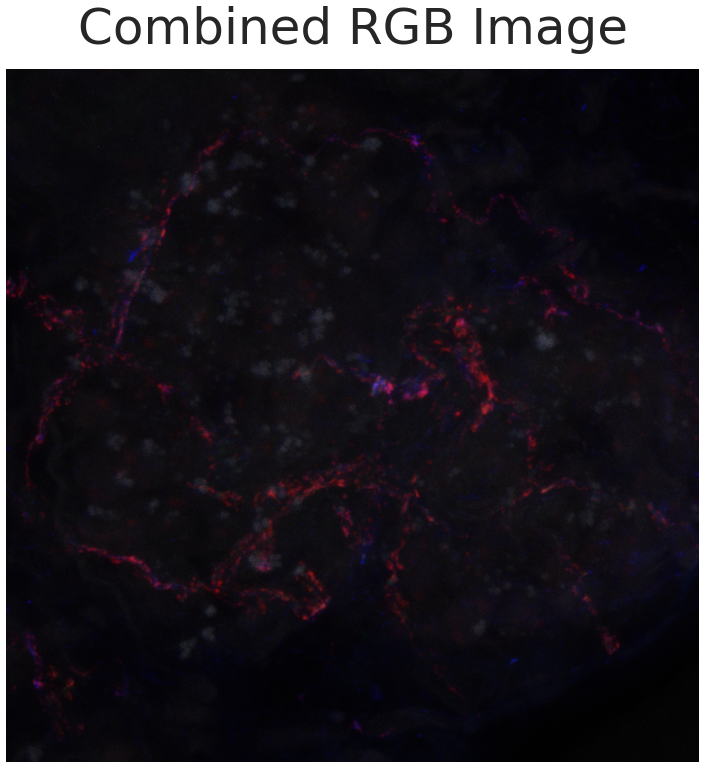

 Image14 : /home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/MSA/MAX_5776 gh.tif.tif


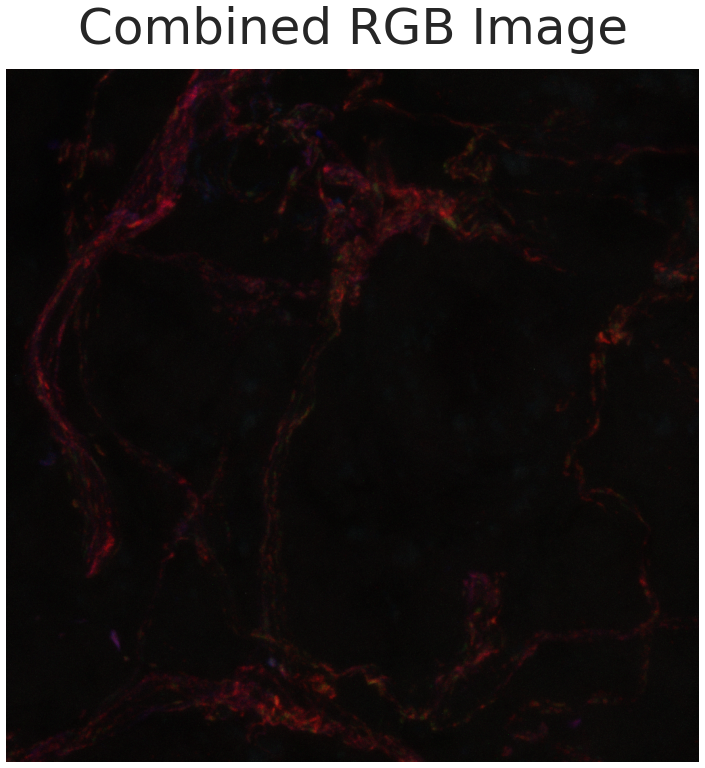

 Image15 : /home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/MSA/MAX_6179 gh.tif.tif


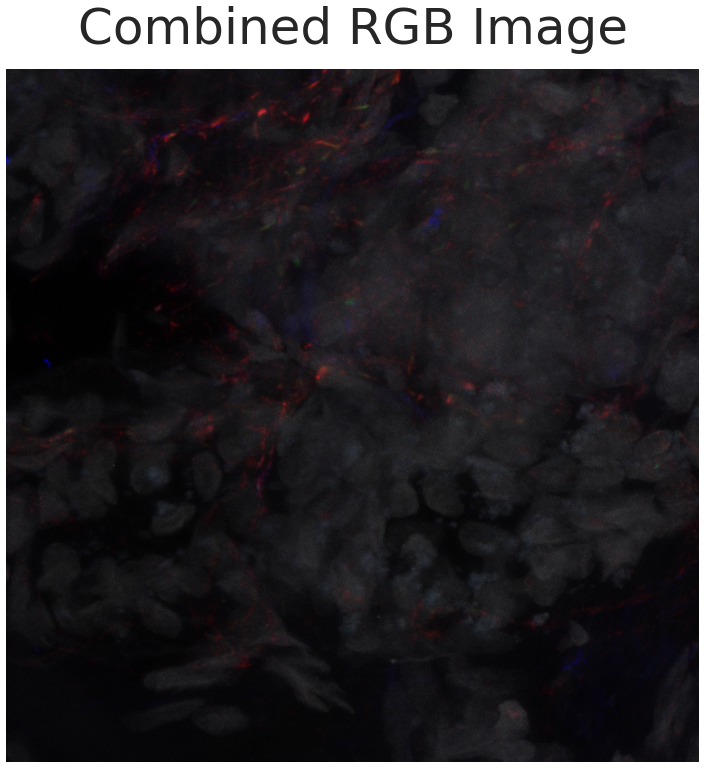

 Image16 : /home/zano/Documents/TESI/FOLDER_CINECA/data/4c_MIP/PD/MAX_6340.lif - 6340 DL VIP red Sinapto gr TH b D grey 63x z 2 pinhole 1 z 05 gh  n2.tif


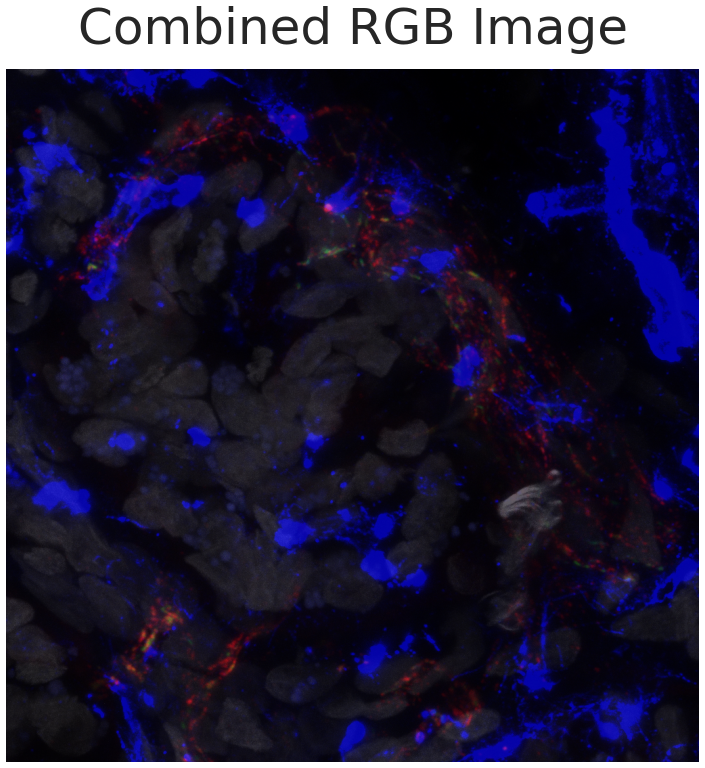

In [215]:
from utils.data_visualization_functions import visualize_tiff
# Visualize some test images to verify correctness
for i in range(len(test_images_paths)):
    print(f" Image{i} : {test_images_paths[i]}")
    visualize_tiff(test_images_paths[i], channel_wise_norm=False)

### VISUALIZING THE EFFECTS OF TRANSFORMATIONS

In [216]:
from utils.transformations_functions import get_transforms
from configs.ConfigLoader import ConfigLoader

#from configs.Config_loader import Config_loader  # Corrected import
yaml_path = os.path.join(os.environ["PROJ_ROOT"], f"configs/{num_input_channels}c/resnet18.yaml")
yaml_path_pretrained = os.path.join(os.environ["PROJ_ROOT"], f"configs/pretrained_3c_monai/resnet18.yaml")
cfg = ConfigLoader(yaml_path_pretrained)  # Corrected usage
#cfg = Config_loader(yaml_path) #Corrected usage
# cfg.set_freezed_layer_index(None)
train_transforms, val_transforms, test_transforms = get_transforms(cfg)

Configuration loaded from /home/zano/Documents/TESI/FOLDER_CINECA/configs/pretrained_3c_monai/base.yaml
Configuration: {'dataset': {'class_names': ['MSA', 'PD']}, 'data_splitting': {'random_seed': 42, 'val_set_size': 0.15, 'test_set_size': 0.1, 'num_folds': 8, 'lr_discovery_folds': 4}, 'data_augmentation': {'resize_spatial_size': [512, 512], 'rand_flip_prob': 0.3, 'rand_flip_spatial_axes': [0, 1], 'rand_rotate90_prob': 0.3, 'rand_rotate90_max_k': 3, 'rand_gaussian_noise_prob': 0.5, 'rand_gaussian_noise_mean': 0.0, 'rand_gaussian_noise_std': 0.1, 'crop_size': [256, 256], 'intensity_augmentation_preset': 'light', 'use_crop': False, 'crop_percentage': 0.95}, 'data_loading': {'batch_size': 32, 'num_workers': 4}, 'model': {'model_name': 'base', 'spatial_dims': 2, 'in_channels': 3, 'out_channels': 2, 'dropout_prob': 0.1, 'patch_size': [16, 16], 'library': 'torchvision'}, 'training': {'num_epochs': 150, 'early_stopping_patience': 35, 'mixup_alpha': 0, 'oversample': True, 'undersample': False,

In [217]:
print("Train transforms:")
for i, transform in enumerate(train_transforms.transforms):
    print(f"{i+1}. {transform.__class__.__name__}")
    if hasattr(transform, '__dict__'):
        # Print key parameters for each transform
        params = {k: v for k, v in transform.__dict__.items() 
                 if not k.startswith('_') and not callable(v)}
        if params:
            print(f"   Parameters: {params}")
print(train_transforms)

Train transforms:
1. CustomTiffFileReader
   Parameters: {'keys': ('image',), 'allow_missing_keys': False}
2. EnsureTyped
   Parameters: {'keys': ('image',), 'allow_missing_keys': False, 'dtype': (torch.float32,)}
3. EnsureTyped
   Parameters: {'keys': ('label',), 'allow_missing_keys': False, 'dtype': (torch.int64,)}
4. Lambdad
   Parameters: {'keys': ('image',), 'allow_missing_keys': False, 'func': (<function from_GBR_to_RGB at 0x73c1cb210c20>,), 'inv_func': (<function no_collation at 0x73c2b7df56c0>,), 'overwrite': (True,)}
5. Resized
   Parameters: {'keys': ('image',), 'allow_missing_keys': False, 'mode': ('bilinear',), 'align_corners': (None,), 'dtype': (<class 'numpy.float32'>,), 'anti_aliasing': (False,), 'anti_aliasing_sigma': (None,)}
6. ScaleIntensityd
   Parameters: {'keys': ('image',), 'allow_missing_keys': False}
7. RandFlipd
   Parameters: {'keys': ('image',), 'allow_missing_keys': False, 'prob': 0.3, 'R': RandomState(MT19937) at 0x73C26BA7AB40}
8. RandFlipd
   Parameters:

In [218]:
# Now you can call the visualization on the original images
print("Visualizing the image 3 channels histogram of the 2 classes before augmentations:")

# visualize_and_compare_pixel_intensity_histograms(
#     images_paths_np,  # original images
#     test_true_labels,
#     class1_name,
#     class0_name
# )

from classes.CustomTiffFileReader import CustomTiffFileReader
import tifffile

def get_tensor_img_from_dict(img_dict):
    img_path = img_dict["image"]
    img_np = tifffile.imread(img_path)  # Read the image as a numpy array
    img_tensor = torch.tensor(img_np, dtype=torch.float32)
    print(f"Image shape : {img_tensor.shape}, dtype: {img_tensor.dtype} device: {img_tensor.device}")
    
    if img_tensor.ndim > 3:
        raise ValueError(f"Image tensor has more than 3 dimensions: {img_tensor.ndim}. Expected 3D tensor (C, H, W).")

    return img_tensor

# Apply the transformations to the training images
def apply_transforms_to_images(images_paths_np, transforms):
    """ returns a list of transformed images as tensors"""
    transformed_images = []
    for path in images_paths_np:
        data_dict = {"image":path,"label":1}
        transformed_dict = transforms(data_dict) # in transforms there's the loading of the tensor

        img_tensor = transformed_dict["image"]
        if img_tensor.ndim > 3:
            raise ValueError(f"Image tensor has more than 3 dimensions: {img_tensor.ndim}. Expected 3D tensor (C, H, W).")

        transformed_images.append(img_tensor)

    return transformed_images

def channel_last(img_array:np.ndarray) -> np.ndarray:
    """Convert image array from (C, H, W) to (H, W, C) format."""
    if img_array.ndim == 3 and img_array.shape[0] in [3, 4]:  # Check if it's a 3-channel or 4-channel image
        return img_array.transpose(1, 2, 0)  # Transpose to (H, W, C)
    return img_array

# For the monai transforms that read from disk, you pass the path as
transformed_images_tensors_list = apply_transforms_to_images(images_paths_np, train_transforms)
transformed_images_np_list = []  # List to store numpy arrays of transformed images in format (H, W, C)
for img_tensor in transformed_images_tensors_list:
    image_array = img_tensor.cpu().numpy() #convert to numpy array
    # print(f"Transformed image shape: {image_array.shape}, dtype: {image_array.dtype}")

    # If needed, transpose from (C, H, W) -> (H, W, C)
    image_array = channel_last(image_array)
    # print(f"Transformed image shape after transpose: {image_array.shape}, dtype: {image_array.dtype}")
    transformed_images_np_list.append(image_array)

print("Visualizing the image 3 channels histogram of the 2 classes after augmentations:")

visualize_and_compare_pixel_intensity_histograms(
    transformed_images_np_list,
    test_true_labels,  # same labels for demonstration
    class1_name,
    class0_name
)

Visualizing the image 3 channels histogram of the 2 classes before augmentations:


RuntimeError: applying transform <monai.transforms.intensity.dictionary.NormalizeIntensityd object at 0x73c2757c29f0>

In [ ]:
# visualize transformations with dictionary transforms
import matplotlib.pyplot as plt
import numpy as np
import torch
import tifffile
import os
from monai.transforms import Compose
from classes.CustomTiffFileReader import CustomTiffFileReader
from monai.transforms import (
    Compose, LoadImaged, EnsureChannelFirstd, Resized, ScaleIntensityd,
    NormalizeIntensityd, RandFlipd, RandRotate90d, RandGaussianNoised, EnsureTyped, LambdaD,
    RandHistogramShiftd, RandAdjustContrastd, RandCoarseDropoutd, CenterSpatialCropd,TorchVisiond,ToTensord
)
from monai.transforms import RandLambdad


from torchvision.transforms import ColorJitter, RandomGrayscale

# Helper function to visualize
normalization_params = {
        "subtrahend": [0.485, 0.456, 0.406],
        "divisor": [0.229, 0.224, 0.225],
    } if cfg.training["pretrained"] else {
        "subtrahend": None,
        "divisor": None,
    }
# Set your actual image path
image_path = images_paths_np[np.random.randint(0, len(images_paths_np))]
assert os.path.exists(image_path), f"File not found: {image_path}"

# Visualize step-by-step
intermediate_results = []
current_data = {"image": image_path, "label": 1} #dummy label

print("\n--- Applying dictionary transforms step-by-step ---")
for transform in train_transforms_list:
    name = transform.__class__.__name__
    # print(f"Applying: {name}")

    current_data = transform(current_data)

    # Handle MetaTensor or Tensor
    img_tensor = current_data["image"]
    # print(f"Output shape: {img_tensor.shape}, dtype: {img_tensor.dtype}")

    # Check if img_tensor is a PyTorch tensor and move to CPU if necessary
    if isinstance(img_tensor, torch.Tensor):
        # print("Converting to NumPy array...")
        img_np = img_tensor.cpu().numpy()
    else:
        # print("Not a PyTorch tensor, numpy array using as is...")
        img_np = img_tensor  # If it's already a NumPy array, use it directly
    intermediate_results.append((name, img_np.copy()))

def normalize_for_imshow(img_data):
    """
    Normalize image data for display with matplotlib's plt.imshow.

    This function assumes the input is either a uint8 NumPy array
    (raw image) or a float32 NumPy array (after transformation).
    - If uint8, returns as-is (imshow handles this natively).
    - If float32, min-max normalizes to [0, 1] for visualization.

    Parameters
    ----------
    img_data : np.ndarray
        The image data to normalize. Must be uint8 or float32.

    Returns
    -------
    np.ndarray or None
        The normalized image data as a NumPy array in the [0, 1] range,
        or the original array if dtype is uint8. Returns None if input is
        not a NumPy array or if the dtype is unsupported.
    """
    if not isinstance(img_data, np.ndarray):
        return None  # Only handle NumPy arrays

    if img_data.dtype == np.uint8:
        return img_data  # imshow handles uint8

    if img_data.dtype == np.float32:
        min_val, max_val = np.min(img_data), np.max(img_data)
        if max_val - min_val > 1e-6:
            img_data = (img_data - min_val) / (max_val - min_val)
        else:
            img_data = img_data - min_val  # Flat image, set to 0
        return np.clip(img_data, 0, 1)

    print(f"Warning: Unsupported dtype {img_data.dtype} for normalization.")
    return None

def plot_image_step(ax, data, title):
    """
    Plot a single transformation step's image on the provided Matplotlib Axes.

    Parameters
    ----------
    ax : matplotlib.axes.Axes
        The axes to plot on.
    data : np.ndarray
        The image data to plot.
    title : str
        The title for the subplot.
    """
    img_shape = getattr(data, 'shape', 'N/A')
    plot_title = f"{title}\nShape: {img_shape}"
    ax.set_title(plot_title, fontsize=10)
    ax.axis('off')

    img_to_show = None
    cmap = None

    if data.ndim == 2:  # Grayscale (H, W)
        img_to_show = normalize_for_imshow(data)
        cmap = 'gray'
    elif data.ndim == 3:
        if data.shape[0] == 1:  # Grayscale with channel (1, H, W)
            img_to_show = normalize_for_imshow(data[0, :, :])
            cmap = 'gray'
        elif data.shape[0] == 3:  # Color (3, H, W) -> (H, W, 3)
            transposed_img = np.transpose(data, (1, 2, 0))
            img_to_show = normalize_for_imshow(transposed_img)
        elif data.shape[0] == 4:  # Color with Alpha (4, H, W) -> (H, W, 3)
            transposed_img = np.transpose(data[:3, :, :], (1, 2, 0))
            img_to_show = normalize_for_imshow(transposed_img)

    if img_to_show is not None:
        ax.imshow(img_to_show, cmap=cmap)


num_steps = len(intermediate_results)
cols = 3
rows = (num_steps + cols - 1) // cols

plt.figure(figsize=(6 * cols, 5 * rows + 1)) # Adjust figsize as needed
plt.suptitle(f"Transformation Steps (Tifffile) for: {os.path.basename(image_path)}", fontsize=16)

for i, (title, img_data) in enumerate(intermediate_results):
    ax = plt.subplot(rows, cols, i + 1)
    plot_image_step(ax, img_data, title)

plt.tight_layout(rect=[0, 0.03, 1, 0.95]) # Adjust layout
plt.show()


--- Applying dictionary transforms step-by-step ---


NameError: name 'train_transforms_list' is not defined

In [ ]:
from utils.data_visualization_functions import display_images_by_class
# from utils.filtering_functions import filter_paths_by_imageIds, filter_paths_by_classIndex
class_names = class_names
display_images_by_class(images_paths_np, labels_np, class_names, ncols=5, normalize=True, overlay_alpha=0.2)

In [ ]:
from utils.data_visualization_functions import visualize_tiff
# for index,path in enumerate(images_paths_np):
#     print(f"Image: {path} index: {index}")
selected_index = 20 #image 5992
visualize_tiff(images_paths_np[selected_index],channel_wise_norm=True)

In [ ]:
from monai.transforms import Compose
from utils.transformations_functions import (
    get_preNormalization_transforms_list,
    _get_intensity_augmentations,   # optional
    NormalizeIntensityd,
)
from configs.ConfigLoader import ConfigLoader

cfg = ConfigLoader("configs/4c/resnet18.yaml")

# A. Pre-normalization (load → channel-first tensor → GBR→RGB → resize → scale[0,1])
pre_tfms = get_preNormalization_transforms_list(cfg, is_supported_by_torchvision=False)

# B. Optional intensity augmentations (confocal-safe)
aug_tfms = _get_intensity_augmentations(cfg)  # or [] to disable

# C. Optional normalization (channel-wise). Comment out if you want “raw post-aug” histograms
norm_tfms = [NormalizeIntensityd(keys=["image"], channel_wise=True)]

# Final pipeline for “transformed” images to analyze
transform_for_hist = Compose(pre_tfms + aug_tfms + norm_tfms)

Configuration loaded from configs/4c/base.yaml
Configuration: {'dataset': {'class_names': ['MSA-P', 'PD']}, 'data_splitting': {'random_seed': 42, 'val_set_size': 0.15, 'test_set_size': 0.1, 'num_folds': 8, 'lr_discovery_folds': 4}, 'data_augmentation': {'resize_spatial_size': [512, 512], 'rand_flip_prob': 0.3, 'rand_flip_spatial_axes': [0, 1], 'rand_rotate90_prob': 0.3, 'rand_rotate90_max_k': 3, 'rand_gaussian_noise_prob': 0.5, 'rand_gaussian_noise_mean': 0.0, 'rand_gaussian_noise_std': 0.1, 'crop_size': [256, 256], 'intensity_augmentation_preset': 'light', 'use_crop': False, 'crop_percentage': 0.95}, 'data_loading': {'batch_size': 32, 'num_workers': 4}, 'model': {'model_name': 'base', 'spatial_dims': 2, 'in_channels': 4, 'out_channels': 2, 'dropout_prob': 0.1, 'patch_size': [16, 16], 'library': 'torchvision'}, 'training': {'num_epochs': 210, 'early_stopping_patience': 35, 'mixup_alpha': 0, 'oversample': True, 'undersample': False, 'weighted_loss': False, 'transfer_learning': False, 'f

In [ ]:
import numpy as np
from monai.data import Dataset, DataLoader

def apply_transforms_to_paths(paths, labels, transform, batch_size=16, num_workers=4):
    """
    Apply a MONAI Compose pipeline that includes file loading (CustomTiffFileReader)
    and return a list of numpy arrays (C,H,W) float32 for downstream analysis/plots.
    """
    data = [{"image": p, "label": int(l)} for p, l in zip(paths, labels)]
    ds = Dataset(data=data, transform=transform)
    dl = DataLoader(ds, batch_size=batch_size, shuffle=False, num_workers=num_workers)

    arrays, out_labels = [], []
    for batch in dl:
        imgs = batch["image"]              # torch.Tensor [B, C, H, W], float32
        lbls = batch["label"].cpu().numpy()
        # Move to CPU numpy
        arrays.extend(imgs.cpu().numpy())  # list of (C,H,W)
        out_labels.extend(lbls.tolist())
    return arrays, np.asarray(out_labels, dtype=int)

arrays, y = apply_transforms_to_paths(images_paths_np, labels_np, transform_for_hist)

In [ ]:
# visualize_and_compare_pixel_intensity_histograms(
#     img_paths=np.array(arrays),      # not used here; pass arrays directly instead:
#     labels=y,
#     class1_name="PD",
#     class0_name="MSA",
#     bins=32,
#     output_path="images/hist_after_transforms.png",
#     robust_zoom=True,
#     lower_percentile=0.5,
#     upper_percentile=99.5,
#     log_x=False,    # True if intensities strictly > 0
#     y_log=False
# )

# Transformation Pipeline Visualizations

This section rebuilds the exact MONAI augmentation pipelines used during training and visualizes the effect of each step for a single sample. Update the parameters in the next cell to switch datasets, configs or the example image.

In [ ]:
import random
from pathlib import Path
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tifffile
import torch
from IPython.display import display
from monai.utils.misc import set_determinism
from configs.ConfigLoader import ConfigLoader
from utils.transformations_functions import get_transforms
from classes.CustomTiffFileReader import CustomTiffFileReader

set_determinism(42)
random.seed(42)
np.random.seed(42)
torch.manual_seed(42)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(42)
if hasattr(torch.backends, "cudnn"):
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
pd.options.display.float_format = "{:,.4f}".format
plt.style.use("ggplot")

In [ ]:
DATA_ROOT = Path("data/3c_MIP")
NON_PRETRAINED_CONFIG = Path("configs/3c/densenet121.yaml")
PRETRAINED_CONFIG = Path("configs/pretrained_3c_monai/densenet121.yaml")

SAMPLE_CLASS = "MSA"  # e.g. "MSA"
SAMPLE_IMAGE_NAME = None  # e.g. "sample_image.tif"
SAMPLE_LABEL = None  # set to an int to override automatic label inference

FOLD_SPECIFIC_STATS = None  # e.g. {"mean": [0.5, 0.5, 0.5], "std": [0.2, 0.2, 0.2]}

In [ ]:
"""
IMAGE TRANSFORMATION PIPELINE UTILITIES
======================================

Utilities to select a sample TIFF image, infer its class label from the folder
structure, execute/record MONAI-style transform pipelines, and visualize each
intermediate step (image + intensity histogram).

Designed for multi-channel confocal TIFFs (e.g., 4-channel G-B-Gr-R).
"""

from __future__ import annotations

from pathlib import Path
from typing import Any, Dict, Iterable, List, Mapping, MutableMapping, Optional, Sequence, Tuple, Union

import numpy as np
import pandas as pd
import torch
import tifffile
import matplotlib.pyplot as plt

# Type aliases to keep signatures readable
PathLike = Union[str, Path]
ArrayLike = Union[np.ndarray, "torch.Tensor"]
ImageND = np.ndarray  # Returned display-ready images are NumPy arrays

# Provided by your codebase (kept as is)
RAW_READER: "CustomTiffFileReader" = CustomTiffFileReader(keys=["image"])


def build_sample_payload(
    cfg: Any,
    image_path: PathLike,
    explicit_label: Optional[int] = None
) -> Dict[str, Union[str, int]]:
    """
    Create a standardized sample dictionary for a single image.

    Parameters
    ----------
    cfg : Any
        Configuration-like object used by `infer_label` (may be dict or an
        object exposing dataset/class metadata).
    image_path : str | pathlib.Path
        Path to the input image.
    explicit_label : int, optional
        Label index to force, bypassing inference.

    Returns
    -------
    dict
        A sample dict with keys:
            - "image": str path to the image
            - "label": int label index
    """
    label = infer_label(cfg, image_path, explicit_label)
    return {"image": str(image_path), "label": label}


def ensure_path(path: PathLike) -> Path:
    """
    Ensure that a given path exists, raising a clear error otherwise.

    Parameters
    ----------
    path : str | pathlib.Path
        Path to validate.

    Returns
    -------
    pathlib.Path
        The same path object, validated.

    Raises
    ------
    FileNotFoundError
        If the specified path does not exist.
    """
    path = Path(path)
    if not path.exists():
        raise FileNotFoundError(
            f"{path} not found. Update DATA_ROOT or the sample selectors above."
        )
    return path


def find_sample_image(
    data_root: PathLike,
    sample_class: Optional[str] = None,
    sample_image: Optional[str] = None
) -> Path:
    """
    Locate a representative `.tif` image within the dataset folder structure.

    Search order:
      1) If `sample_image` is given, return it (optionally within `sample_class`).
      2) If `sample_class` is given, search that subfolder for the first *.tif*.
      3) Otherwise, scan subfolders; if none exist, scan root.
      4) Fallback: any *.tif* directly under root.

    Parameters
    ----------
    data_root : str | pathlib.Path
        Root directory containing class subfolders or TIFF images.
    sample_class : str, optional
        Class subfolder name (e.g., "PD" or "MSA-P").
    sample_image : str, optional
        Specific image filename; if provided, lookup is direct.

    Returns
    -------
    pathlib.Path
        Path to a found TIFF image.

    Raises
    ------
    FileNotFoundError
        If no valid `.tif` image is found.
    """
    data_root = ensure_path(data_root)

    # Direct path if a specific image is given
    if sample_image:
        candidate = (
            data_root / sample_image
            if sample_class is None
            else data_root / sample_class / sample_image
        )
        return ensure_path(candidate)

    # Otherwise, search in class or root directories
    search_dirs: List[Path] = []
    if sample_class:
        search_dirs.append(ensure_path(data_root / sample_class))
    else:
        search_dirs = sorted([p for p in data_root.iterdir() if p.is_dir()])
        if not search_dirs:
            search_dirs = [data_root]

    for directory in search_dirs:
        images = sorted(directory.glob("*.tif*"))
        if images:
            return images[0]

    # Fallback: look directly under root
    fallback = sorted(data_root.glob("*.tif*"))
    if fallback:
        return fallback[0]

    raise FileNotFoundError(f"No .tif images found under {data_root}.")


def infer_label(
    cfg: Any,
    image_path: PathLike,
    explicit_label: Optional[int] = None
) -> int:
    """
    Infer a label index for a given image path.

    Label resolution order:
      1) Use `explicit_label` if provided.
      2) Derive from folder name matched against the config class names.
         Supports:
           - cfg.get_class_names() -> Sequence[str]
           - cfg.dataset['class_names'] (dict form)
           - cfg['class_names']       (plain dict)

    Parameters
    ----------
    cfg : Any
        Configuration containing class metadata.
    image_path : str | pathlib.Path
        Path to the sample image.
    explicit_label : int, optional
        Explicitly provided label index.

    Returns
    -------
    int
        Inferred label index. Defaults to 0 when no match is found.
    """
    if explicit_label is not None:
        return int(explicit_label)

    class_names: Optional[Sequence[str]] = None

    if hasattr(cfg, "get_class_names"):
        class_names = cfg.get_class_names()  # type: ignore[assignment]
    if not class_names and isinstance(getattr(cfg, "dataset", None), dict):
        class_names = cfg.dataset.get("class_names", [])  # type: ignore[index]
    elif not class_names and isinstance(cfg, dict):
        class_names = cfg.get("class_names", [])

    class_names = [str(name).lower() for name in class_names or []]
    parent_name = Path(image_path).parent.name.lower()

    for idx, name in enumerate(class_names):
        if parent_name == name:
            return idx
    return 0


def to_numpy(image: ArrayLike) -> np.ndarray:
    """
    Convert a PyTorch tensor or array-like image to a NumPy array.

    Parameters
    ----------
    image : torch.Tensor | numpy.ndarray

    Returns
    -------
    numpy.ndarray
        A CPU NumPy array (copied from tensor if necessary).
    """
    if torch.is_tensor(image):
        return image.detach().cpu().numpy()
    return np.asarray(image)


def compute_stats(image: ArrayLike) -> Dict[str, float]:
    """
    Compute simple descriptive statistics of an image.

    Parameters
    ----------
    image : torch.Tensor | numpy.ndarray

    Returns
    -------
    dict
        Keys:
            - 'min' : float
            - 'max' : float
            - 'mean': float
            - 'std' : float (population std, ddof=0)
    """
    arr = to_numpy(image).astype(np.float32)
    return {
        "min": float(arr.min()),
        "max": float(arr.max()),
        "mean": float(arr.mean()),
        "std": float(arr.std(ddof=0)),
    }


def describe_transform(transform: Any) -> str:
    """
    Produce a human-readable description of a transform.

    Special handling:
      - MONAI `LambdaD`: append underlying function name if available.
      - MONAI `OneOf`: append the chosen transform if determinable.

    Parameters
    ----------
    transform : Any
        Transform instance (e.g., MONAI transform).

    Returns
    -------
    str
        Descriptive transform name.
    """
    name = transform.__class__.__name__

    # Handle MONAI LambdaD with embedded function
    if name == "LambdaD":
        func = getattr(transform, "func", None)
        if hasattr(func, "__name__"):
            name += f" ({func.__name__})"

    # Handle MONAI OneOf for probabilistic transforms
    if name == "OneOf":
        chosen = getattr(transform, "last_transform", None)
        if chosen is None:
            idx = getattr(transform, "_choice", None)
            if idx is not None and 0 <= idx < len(transform.transforms):
                chosen = transform.transforms[idx]
        if chosen is not None:
            name += f" -> {chosen.__class__.__name__}"

    return name


def prepare_for_display(image: ArrayLike) -> ImageND:
    """
    Normalize and rearrange image data for display with matplotlib.

    - Accepts (C, H, W), (H, W, C), or (H, W).
    - Converts (C, H, W) with C in {1, 3, 4} to (H, W, C).
    - Drops channels beyond RGB.
    - Squeezes single-channel 3D to (H, W).
    - Normalizes to [0, 1] (min-max per image). If degenerate, returns zeros.

    Parameters
    ----------
    image : torch.Tensor | numpy.ndarray

    Returns
    -------
    numpy.ndarray
        Image in H×W or H×W×3 format normalized to [0, 1].
    """
    arr = to_numpy(image).astype(np.float32)

    # Convert from (C, H, W) to (H, W, C)
    if arr.ndim == 3 and arr.shape[0] in (1, 3, 4):
        arr = np.transpose(arr, (1, 2, 0))
    # Drop excess channels beyond RGB
    if arr.ndim == 3 and arr.shape[-1] > 3:
        arr = arr[..., :3]
    # Squeeze single-channel
    if arr.ndim == 3 and arr.shape[-1] == 1:
        arr = arr[..., 0]

    arr_min, arr_max = arr.min(), arr.max()
    if arr_max > arr_min:
        arr = (arr - arr_min) / (arr_max - arr_min)
    else:
        arr = np.zeros_like(arr)
    return arr


def collect_transformation_steps(
    pipeline: Any,
    sample_dict: Mapping[str, Any],
    include_original: bool = True
) -> List[Dict[str, Any]]:
    """
    Execute a transform pipeline and record intermediate images/statistics.

    The pipeline is expected to be a MONAI `Compose`-like object exposing:
      - `.set_random_state(seed)` for determinism
      - `.transforms` iterable for step-by-step application
      - Each transform callable on a dict {"image": <path or array>, "label": int}

    Parameters
    ----------
    pipeline : Any
        A MONAI/TorchIO-style composed pipeline.
    sample_dict : Mapping[str, Any]
        Sample with at least {"image": path-like, "label": int}.
    include_original : bool, default True
        If True, reads and stores the raw TIFF as stage 0.

    Returns
    -------
    list of dict
        Each entry has keys:
            - "stage": int
            - "name" : str (transform description)
            - "image": np.ndarray or torch.Tensor (copy/cloned)
            - "stats": dict (min/max/mean/std)
    """
    history: List[Dict[str, Any]] = []
    pipeline = pipeline.set_random_state(42)
    working: Dict[str, Any] = {
        "image": str(sample_dict["image"]),
        "label": int(sample_dict.get("label", 0)),
    }

    if include_original:
        try:
            raw_image = RAW_READER({"image": working["image"]})["image"]
        except Exception:
            raw_image = tifffile.imread(working["image"])
        history.append({
            "stage": 0,
            "name": "Original TIFF (GBR)",
            "image": raw_image,
            "stats": compute_stats(raw_image),
        })

    for idx, transform in enumerate(pipeline.transforms, start=1):
        working = transform(working)
        image = working["image"]
        if torch.is_tensor(image):
            stored = image.detach().cpu().clone()
        else:
            stored = np.array(image, copy=True)
        history.append({
            "stage": idx,
            "name": describe_transform(transform),
            "image": stored,
            "stats": compute_stats(stored),
        })

    return history


def summarize_steps(steps: Sequence[Mapping[str, Any]]) -> pd.DataFrame:
    """
    Convert a list of transformation steps into a summary DataFrame.

    Parameters
    ----------
    steps : sequence of mapping
        Output of `collect_transformation_steps`.

    Returns
    -------
    pandas.DataFrame
        Columns: ["stage", "transform", "min", "max", "mean", "std"]
    """
    rows: List[Dict[str, Any]] = []
    for step in steps:
        row: Dict[str, Any] = {"stage": step["stage"], "transform": step["name"]}
        row.update(step["stats"])
        rows.append(row)
    return pd.DataFrame(rows)


def plot_transformation_steps(steps: Sequence[Mapping[str, Any]], title: str) -> None:
    """
    Plot images and intensity histograms for a list of transformation steps.

    Parameters
    ----------
    steps : sequence of mapping
        Output of `collect_transformation_steps`.
        Each step must contain keys {"image", "stage", "name", "stats"}.
    title : str
        Suptitle for the figure.

    Returns
    -------
    None
    """
    if not steps:
        print("No steps to visualize.")
        return

    fig, axes = plt.subplots(len(steps), 2, figsize=(11, 4 * len(steps)))
    if len(steps) == 1:
        axes = axes.reshape(1, -1)

    for idx, step in enumerate(steps):
        img_ax, hist_ax = axes[idx]
        display_img = prepare_for_display(step["image"])

        # --- Image view ---
        if display_img.ndim == 2:
            img_ax.imshow(display_img, cmap="gray")
        else:
            img_ax.imshow(display_img)
        img_ax.set_title(f"{step['stage']:02d} - {step['name']}")
        img_ax.axis("off")

        # --- Histogram ---
        flat = to_numpy(step["image"]).ravel()
        hist_ax.hist(flat, bins=60, color="#1f77b4", alpha=0.85)
        hist_ax.set_title("Intensity distribution")
        hist_ax.set_xlabel("value")
        hist_ax.set_ylabel("pixels")

        stats = step["stats"]
        stats_text = "\n".join([
            f"min  {stats['min']:.3f}",
            f"max  {stats['max']:.3f}",
            f"mean {stats['mean']:.3f}",
            f"std  {stats['std']:.3f}",
        ])
        hist_ax.text(
            0.95, 0.95, stats_text,
            ha="right", va="top", transform=hist_ax.transAxes,
            fontsize=9, bbox=dict(facecolor="white", alpha=0.7, edgecolor="none"),
        )

    fig.suptitle(title, fontsize=16)
    fig.tight_layout()
    plt.show()


def plot_transformation_images(steps, title, cols=4):
    if not steps:
        print("No steps to visualize.")
        return
    cols = max(1, int(cols))
    rows = math.ceil(len(steps) / cols)
    fig, axes = plt.subplots(rows, cols, figsize=(4 * cols, 4.2 * rows))
    if rows == 1 and cols == 1:
        axes = np.array([[axes]])
    elif rows == 1:
        axes = np.array([axes])
    elif cols == 1:
        axes = np.array([[ax] for ax in axes])
    for idx, step in enumerate(steps):
        r, c = divmod(idx, cols)
        ax = axes[r][c]
        display_img = prepare_for_display(step["image"])
        cmap = "gray" if display_img.ndim == 2 else None
        ax.imshow(display_img, cmap=cmap)
        ax.set_title(f"{step['stage']:02d} - {step['name']}", fontsize=10)
        ax.axis("off")
    total_slots = rows * cols
    for idx in range(len(steps), total_slots):
        r, c = divmod(idx, cols)
        axes[r][c].axis("off")
    fig.suptitle(title, fontsize=16)
    fig.tight_layout()
    plt.show()


In [ ]:
SAMPLE_IMAGE_PATH = find_sample_image(DATA_ROOT, SAMPLE_CLASS, SAMPLE_IMAGE_NAME)
print(f"Selected sample: {SAMPLE_IMAGE_PATH}")
print(f"Class folder: {SAMPLE_IMAGE_PATH.parent.name}")
try:
    size_mb = SAMPLE_IMAGE_PATH.stat().st_size / 1e6
    print(f"File size: {size_mb:.2f} MB")
except OSError:
    pass

Selected sample: data/3c_MIP/MSA/MAX_4092.lif - 4092 DL VIP red Sinapto gr TH b D grey 63x z 2 pinhole 1 z 05 gh 2.tif
Class folder: MSA
File size: 3.15 MB


Configuration loaded from configs/3c/base.yaml
Configuration: {'dataset': {'class_names': ['MSA', 'PD']}, 'data_splitting': {'random_seed': 42, 'val_set_size': 0.15, 'test_set_size': 0.1, 'num_folds': 8, 'lr_discovery_folds': 4}, 'data_augmentation': {'resize_spatial_size': [512, 512], 'rand_flip_prob': 0.3, 'rand_flip_spatial_axes': [0, 1], 'rand_rotate90_prob': 0.3, 'rand_rotate90_max_k': 3, 'rand_gaussian_noise_prob': 0.5, 'rand_gaussian_noise_mean': 0.0, 'rand_gaussian_noise_std': 0.1, 'crop_size': [256, 256], 'intensity_augmentation_preset': 'light', 'use_crop': False, 'crop_percentage': 0.95}, 'data_loading': {'batch_size': 32, 'num_workers': 4}, 'model': {'model_name': 'base', 'spatial_dims': 2, 'in_channels': 3, 'out_channels': 2, 'dropout_prob': 0.1, 'patch_size': [16, 16], 'library': 'torchvision'}, 'training': {'num_epochs': 150, 'early_stopping_patience': 35, 'mixup_alpha': 0, 'oversample': True, 'undersample': False, 'weighted_loss': False, 'transfer_learning': False, 'fre

,stage,transform,min,max,mean,std
0,0,Original TIFF (GBR),0.0000,255.0000,9.1381,17.1614
1,1,CustomTiffFileReader,0.0000,255.0000,9.1381,17.1614
2,2,EnsureTyped,0.0000,255.0000,9.1381,17.1614
3,3,EnsureTyped,0.0000,255.0000,9.1381,17.1614
4,4,Lambdad,0.0000,255.0000,9.1381,17.1614
5,5,Resized,0.0000,255.0000,9.1381,16.9080
6,6,ScaleIntensityd,0.0000,1.0000,0.0358,0.0663
7,7,RandFlipd,0.0000,1.0000,0.0358,0.0663
8,8,RandFlipd,0.0000,1.0000,0.0358,0.0663
9,9,RandRotate90d,0.0000,1.0000,0.0358,0.0663


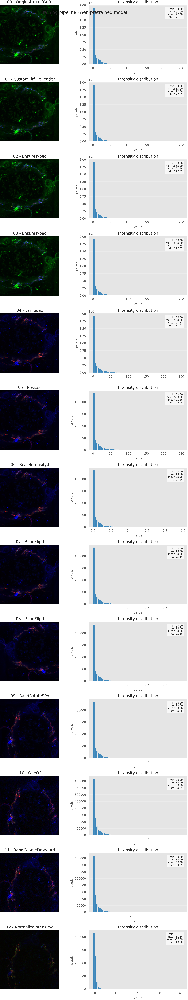

In [ ]:
non_pretrained_cfg = ConfigLoader(str(NON_PRETRAINED_CONFIG))
non_pretrained_cfg.training["transfer_learning"] = False
non_pretrained_cfg.training["pretrained"] = False

sample_payload = build_sample_payload(non_pretrained_cfg, SAMPLE_IMAGE_PATH, SAMPLE_LABEL)
print(f"Using label {sample_payload['label']} for {SAMPLE_IMAGE_PATH.name}")

train_transforms_non_pretrained, _, _ = get_transforms(
    non_pretrained_cfg, fold_specific_stats=FOLD_SPECIFIC_STATS
)
non_pretrained_steps = collect_transformation_steps(train_transforms_non_pretrained, sample_payload)

display(summarize_steps(non_pretrained_steps))
plot_transformation_steps(non_pretrained_steps, "Training pipeline - non-pretrained model")

In [ ]:
pretrained_cfg = ConfigLoader(str(PRETRAINED_CONFIG))
pretrained_cfg.training["transfer_learning"] = True
pretrained_cfg.training["pretrained"] = True
pretrained_cfg.set_pretrained_weights("imagenet")
pretrained_cfg.set_model_input_channels(3)

sample_payload_pretrained = build_sample_payload(pretrained_cfg, SAMPLE_IMAGE_PATH, SAMPLE_LABEL)
print(f"Using label {sample_payload_pretrained['label']} for {SAMPLE_IMAGE_PATH.name}")

train_transforms_pretrained, _, _ = get_transforms(
    pretrained_cfg, fold_specific_stats=FOLD_SPECIFIC_STATS
)
pretrained_steps = collect_transformation_steps(train_transforms_pretrained, sample_payload_pretrained)
pretrained_steps_df = summarize_steps(pretrained_steps)
display(pretrained_steps_df)
plot_transformation_steps(pretrained_steps, "Training pipeline - pretrained model")


Configuration loaded from configs/pretrained_3c_monai/base.yaml
Configuration: {'dataset': {'class_names': ['MSA', 'PD']}, 'data_splitting': {'random_seed': 42, 'val_set_size': 0.15, 'test_set_size': 0.1, 'num_folds': 8, 'lr_discovery_folds': 4}, 'data_augmentation': {'resize_spatial_size': [512, 512], 'rand_flip_prob': 0.3, 'rand_flip_spatial_axes': [0, 1], 'rand_rotate90_prob': 0.3, 'rand_rotate90_max_k': 3, 'rand_gaussian_noise_prob': 0.5, 'rand_gaussian_noise_mean': 0.0, 'rand_gaussian_noise_std': 0.1, 'crop_size': [256, 256], 'intensity_augmentation_preset': 'light', 'use_crop': False, 'crop_percentage': 0.95}, 'data_loading': {'batch_size': 32, 'num_workers': 4}, 'model': {'model_name': 'base', 'spatial_dims': 2, 'in_channels': 3, 'out_channels': 2, 'dropout_prob': 0.1, 'patch_size': [16, 16], 'library': 'torchvision'}, 'training': {'num_epochs': 150, 'early_stopping_patience': 35, 'mixup_alpha': 0, 'oversample': True, 'undersample': False, 'weighted_loss': False, 'transfer_learn

,stage,transform,min,max,mean,std
0,0,Original TIFF (GBR),0.0000,255.0000,9.1381,17.1614
1,1,CustomTiffFileReader,0.0000,255.0000,9.1381,17.1614
2,2,EnsureTyped,0.0000,255.0000,9.1381,17.1614
3,3,EnsureTyped,0.0000,255.0000,9.1381,17.1614
4,4,Lambdad,0.0000,255.0000,9.1381,17.1614
5,5,Resized,0.0000,255.0000,9.1381,16.9080
6,6,ScaleIntensityd,0.0000,1.0000,0.0358,0.0663
7,7,RandFlipd,0.0000,1.0000,0.0358,0.0663
8,8,RandFlipd,0.0000,1.0000,0.0358,0.0663
9,9,RandRotate90d,0.0000,1.0000,0.0358,0.0663


In [ ]:
pretrained_steps_df["transform"]

0      Original TIFF (GBR)
1     CustomTiffFileReader
2              EnsureTyped
3              EnsureTyped
4                  Lambdad
5                  Resized
6          ScaleIntensityd
7                RandFlipd
8                RandFlipd
9            RandRotate90d
10                   OneOf
11      RandCoarseDropoutd
12     NormalizeIntensityd
Name: transform, dtype: object

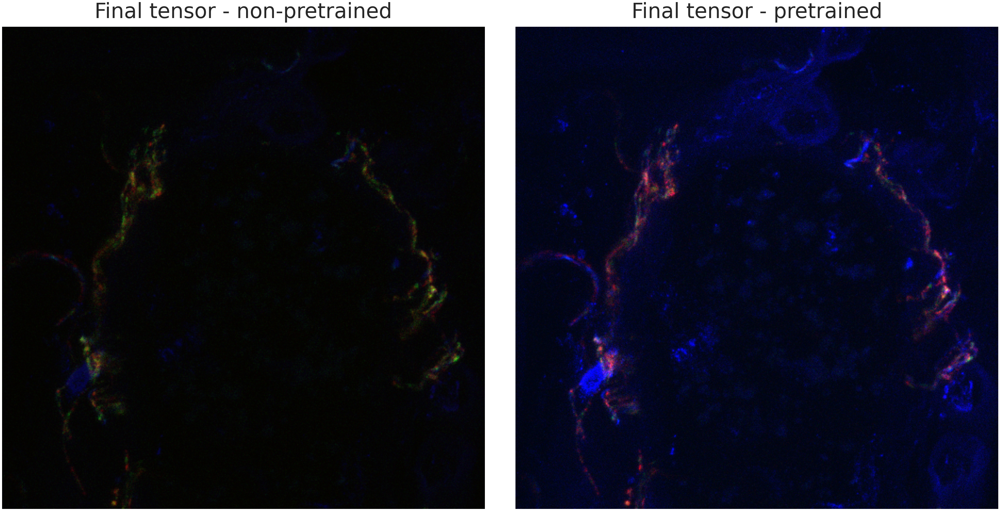

,pipeline,min,max,mean,std
0,non-pretrained,-0.9006,41.1356,-0.0000,1.0000
1,pretrained,-2.1179,2.6400,-1.8185,0.3847


In [ ]:
if "non_pretrained_steps" in globals() and "pretrained_steps" in globals():
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].imshow(prepare_for_display(non_pretrained_steps[-1]["image"]))
    axes[0].set_title("Final tensor - non-pretrained")
    axes[0].axis("off")
    axes[1].imshow(prepare_for_display(pretrained_steps[-1]["image"]))
    axes[1].set_title("Final tensor - pretrained")
    axes[1].axis("off")
    plt.tight_layout()
    plt.show()

    comparison = pd.DataFrame([
        {"pipeline": "non-pretrained", **non_pretrained_steps[-1]["stats"]},
        {"pipeline": "pretrained", **pretrained_steps[-1]["stats"]},
    ])
    display(comparison)
else:
    print("Run both pipelines above to compare their outputs.")

In [ ]:
if "non_pretrained_steps" in globals():
    plot_transformation_images(non_pretrained_steps, "Transformation snapshots - non-pretrained")
else:
    print("Run the non-pretrained pipeline cell first.")

if "pretrained_steps" in globals():
    plot_transformation_images(pretrained_steps, "Transformation snapshots - pretrained")
else:
    print("Run the pretrained pipeline cell first.")


NameError: name 'plot_transformation_images' is not defined